In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

1.	Выбрать три разных изображения, хотя бы на одном из которых присутствуют объекты с легко визуально выделяемыми краями. Применить к изображениям детектор Харриса, Ши-Томаси.

In [ ]:
!curl https://upload.wikimedia.org/wikipedia/commons/thumb/a/ac/Dili%C5%BEansk%C3%A1_p%C5%99%C3%ADroda.jpg/960px-Dili%C5%BEansk%C3%A1_p%C5%99%C3%ADroda.jpg > /content/forest.jpg
!curl https://fbi.cults3d.com/uploaders/21898570/illustration-file/1d861812-35f1-464b-a58f-2d68bd15e4c1/figuras_geom%C3%A9tricas.png > /content/figures.jpg
!curl https://kupiploshadku.ru/wa-data/public/shop/products/74/05/574/images/2192/2192.970.jpg > /content/game.jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  217k  100  217k    0     0   274k      0 --:--:-- --:--:-- --:--:--  274k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 99792  100 99792    0     0  86540      0  0:00:01  0:00:01 --:--:-- 86549
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  114k  100  114k    0     0  60688      0  0:00:01  0:00:01 --:--:-- 60668


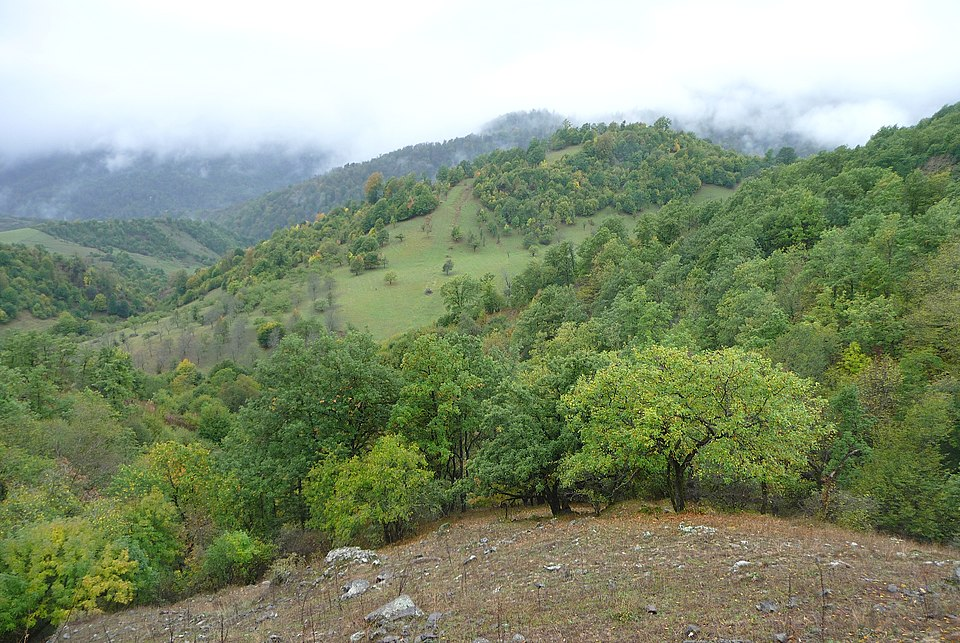

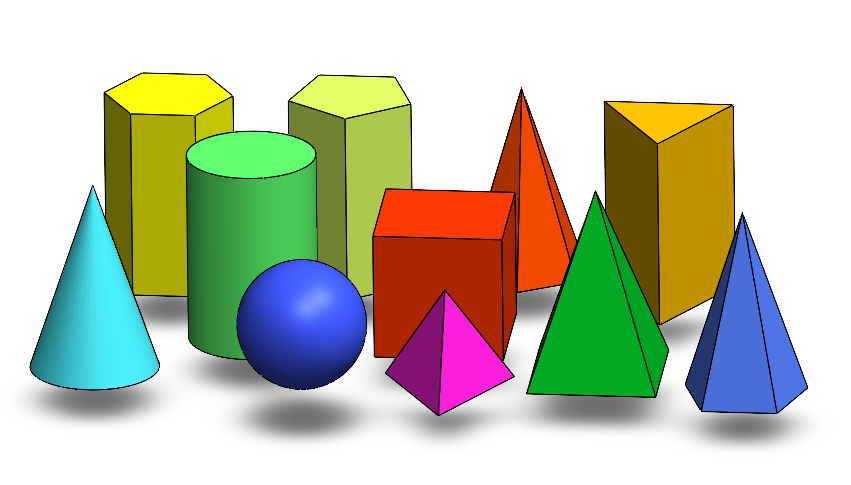

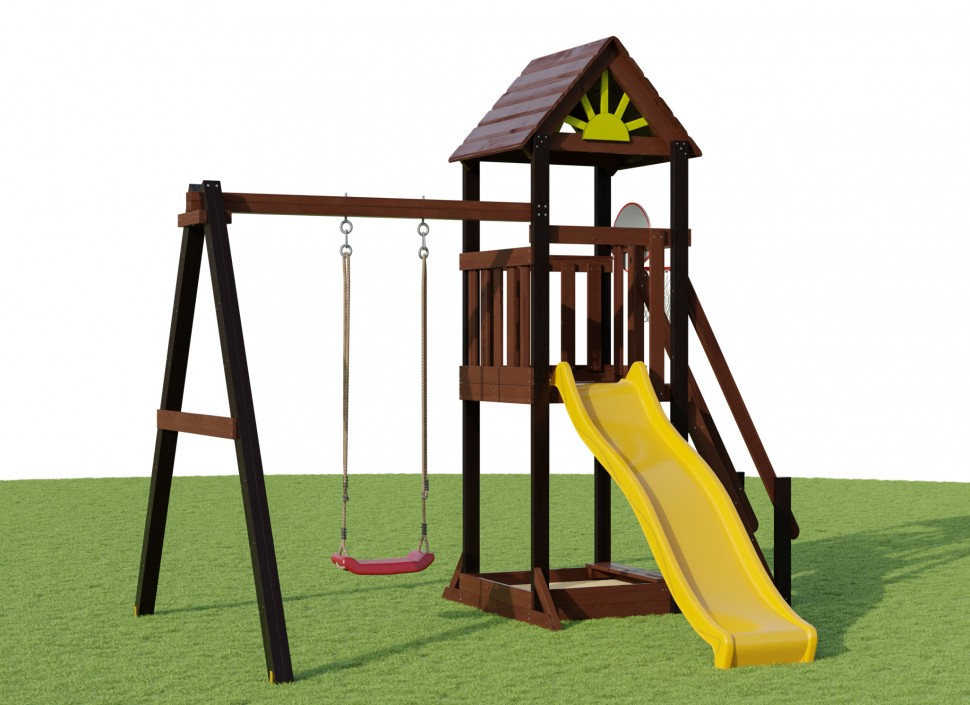

In [ ]:
forest = cv2.imread('/content/forest.jpg')
cv2_imshow(forest)
figures = cv2.imread('/content/figures.jpg')
cv2_imshow(figures)
game = cv2.imread('/content/game.jpg')
cv2_imshow(game)

In [ ]:
def search_corners(image, threshold=0.01):
  image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  harris_corners = image.copy()
  shi_tomasi_corners = image.copy()

  points = cv2.cornerHarris(src=image_gray, blockSize=5, ksize=3, k=0.2)
  harris_corners[points > threshold * points.max()] = [0, 255, 0]
  corners = cv2.goodFeaturesToTrack(image=image_gray, maxCorners=100, qualityLevel=0.01, minDistance=10)
  corners = np.int32(corners)
  for i in corners:
    x,y = i.ravel()
    cv2.circle(shi_tomasi_corners, (x, y), 3, (0, 255, 0), -1)


  plt.imshow(harris_corners, cmap='gray')
  plt.show()
  plt.imshow(shi_tomasi_corners, cmap='gray')
  plt.show()


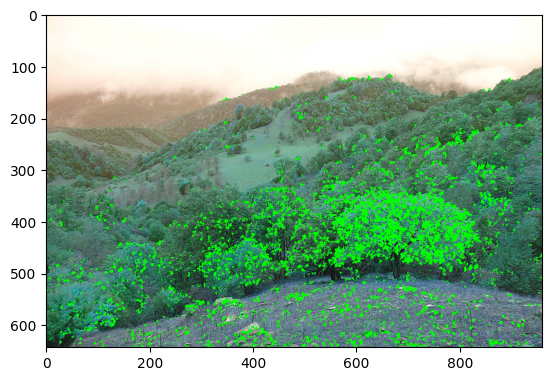

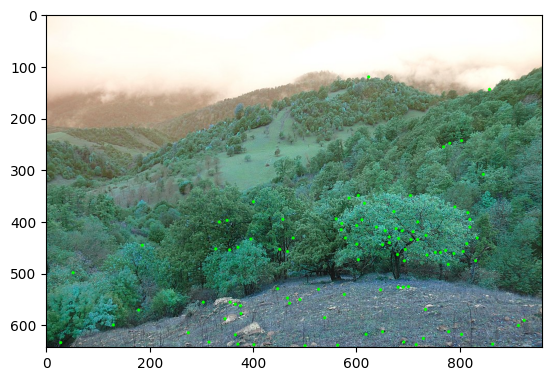

In [ ]:
search_corners(forest)

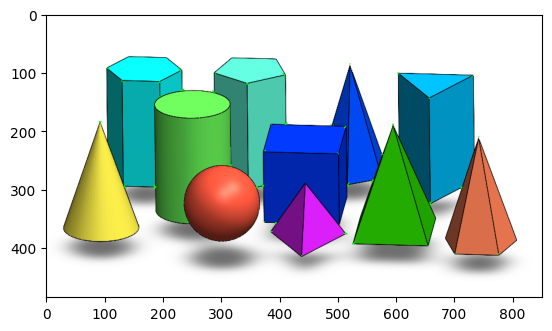

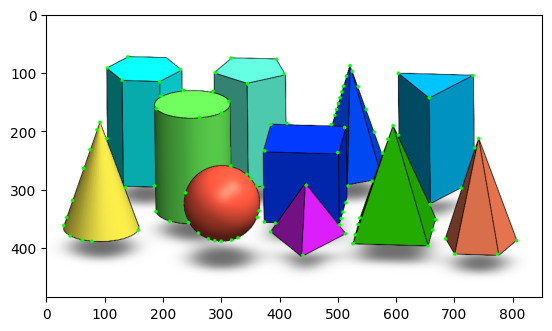

In [ ]:
search_corners(figures)

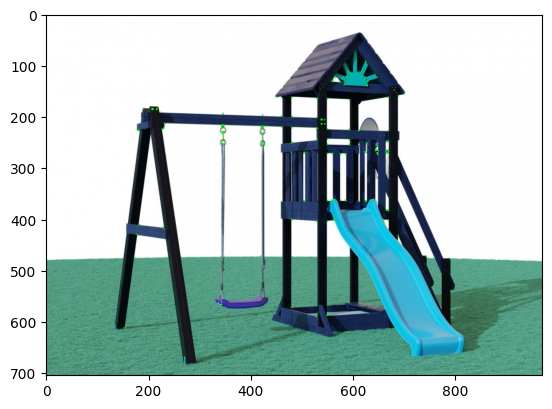

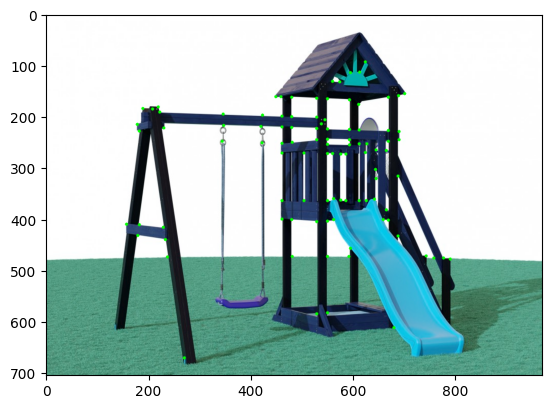

In [ ]:
search_corners(game)

Выбрать изображение, содержащее не менее 3-х одинаковых объектов. Составить изображение (шаблон) из точек, соответствующих положению объекта на изображении.

In [ ]:
!curl https://i.postimg.cc/mLs5XpsT/image.png > /content/collage.jpg
collage = cv2.imread('/content/collage.jpg')
collage_gray = cv2.imread('/content/collage.jpg', 0)

# collage = cv2.imread('/home/maximkrasavtsev/study/cv/image.png')
# collage_gray = cv2.imread('/home/maximkrasavtsev/study/cv/image.png', 0)

In [ ]:
cv2_imshow(collage)
# cv2.imshow("collage", collage)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

qt.qpa.plugin: Could not find the Qt platform plugin "wayland" in "/home/maximkrasavtsev/.local/lib/python3.10/site-packages/cv2/qt/plugins"


In [ ]:
template = collage[645:690, 60:110]
template_gray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)
cv2_imshow(template)
# cv2.imshow("template", template)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [ ]:
corners = cv2.goodFeaturesToTrack(image=collage_gray, maxCorners=100, qualityLevel=0.001, minDistance=1)
template_cornets = cv2.goodFeaturesToTrack(image=template_gray, maxCorners=100, qualityLevel=0.01, minDistance=10)

In [ ]:
three_res = collage.copy()
corners = np.int32(corners)
for i in corners:
  x, y = i.ravel()
  cv2.circle(three_res, (x, y), 3, 255, -1)
cv2_imshow(three_res)
# cv2.imshow("three_res", three_res)
# cv2.waitKey(0)
# cv2.destroyAllWindows()


Для изображения и шаблона из пункта 2 (или других изображений с соответствующими характеристиками), с помощью SIFT:


Нарисовать ключевые точки на изображении и шаблоне. Вывести координаты, ориентацию особых точек.

In [ ]:
sift = cv2.SIFT_create() # Инициализация SIFT детектор
# Получение ключевых точек kp и их дескрипторов des
collage_kp, collage_des = sift.detectAndCompute(collage_gray, None)
template_kp, template_des = sift.detectAndCompute(template_gray, None)

In [ ]:
print(collage_kp[0].pt) # координаты ключеврй точки
print(collage_kp[0].size) # диаметр значимой окрестности ключевой точки
print(collage_kp[0].angle) # найденная ориентация ключевой точки [0,360) градусов
print(collage_kp[0].response) # ответ, по которому были выбраны наиболее ключевые точки
print(collage_kp[0].octave) # октава [5](слой пирамиды), из которого была извлечена ключевая точка

(16.450241088867188, 276.3866882324219)
14.15746021270752
183.41189575195312
0.027721848338842392
15663873


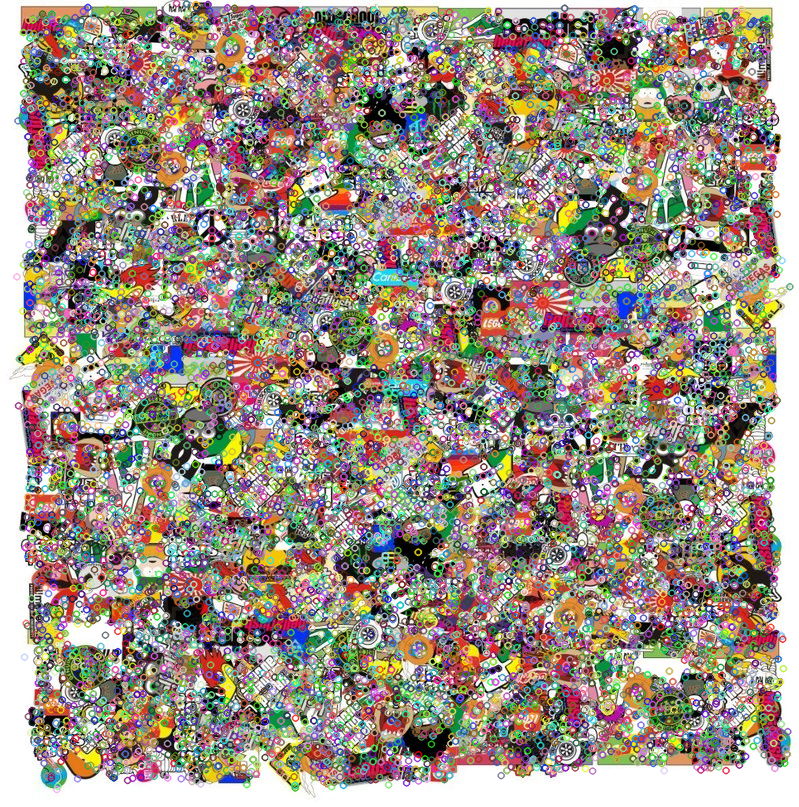

In [ ]:
three_res = collage.copy()
cv2.drawKeypoints(collage, collage_kp, three_res)
cv2_imshow(three_res)
# cv2.imshow("three_res", three_res)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

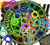

In [ ]:
template_res = template.copy()
cv2.drawKeypoints(template, template_kp, template_res)
cv2_imshow(template_res)
# cv2.imshow("template_res", template_res)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

Используя bf = cv2.BFMatcher(), bf.knnMatch() и выбрав наиболее подходящий коэффициент для .distance (см. презентацию лекции) получить пары соответствующих особых точек, отобразить результаты cv2.drawMatchesKnn при сравнении шаблона и изображения. При этом по очереди использовать каждое допустимое значение параметра flags.

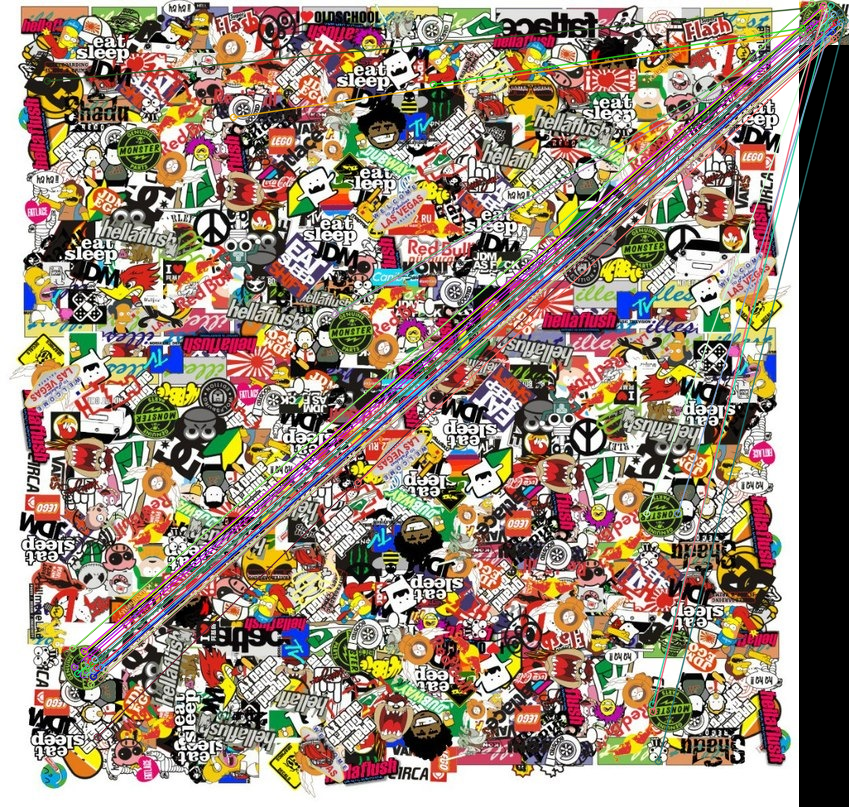

In [ ]:
bf = cv2.BFMatcher(normType=cv2.NORM_L2, crossCheck=True)
matches = bf.match(collage_des, template_des)
cv2_imshow(cv2.drawMatches(collage, collage_kp, template, template_kp, matches1to2=matches, outImg=None, flags=2))
# cv2.imshow("matches", cv2.drawMatches(collage, collage_kp, template, template_kp, matches1to2=matches, outImg=None, flags=2))
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [ ]:
bf = cv2.BFMatcher(normType=cv2.NORM_L2)
matches = bf.knnMatch(collage_des, template_des, k=2)

good = []
for m, n in matches:
  if m.distance < 0.6*n.distance:
    good.append([m])

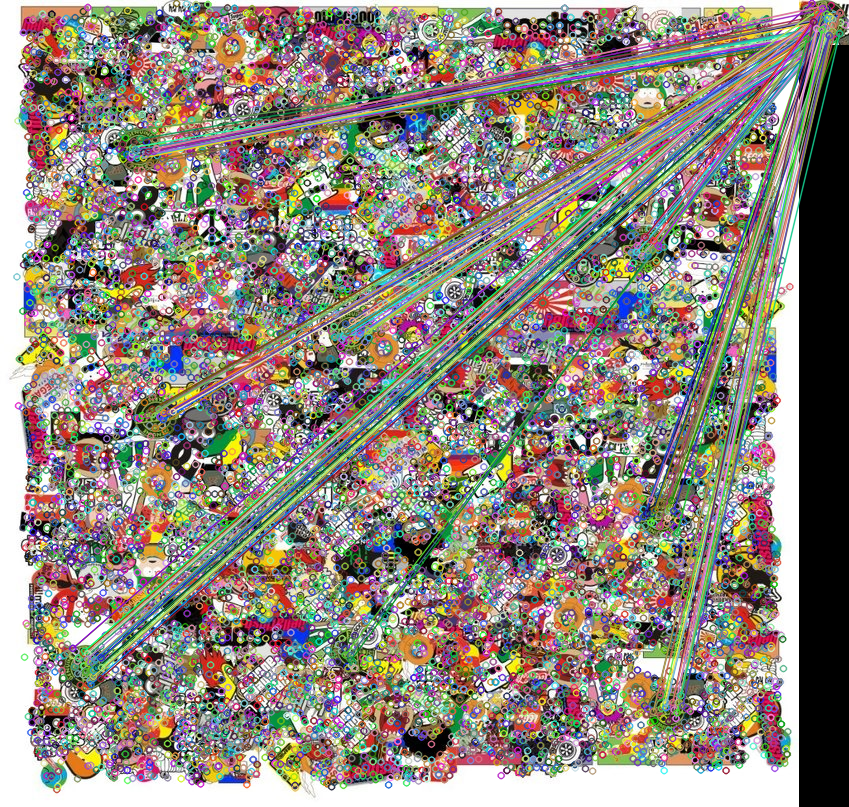

In [ ]:
out = np.full((collage.shape[0], collage.shape[1] + template.shape[1], 3), [0, 0, 0], np.uint8)
out[:collage.shape[0], :collage.shape[1]] = collage
out[:template.shape[0], collage.shape[1]:collage.shape[1] + template.shape[1]] = template
cv2_imshow(cv2.drawMatchesKnn(collage, collage_kp, template, template_kp, matches1to2=good, outImg=None, flags=0))



# cv2.imshow("matches knn, flag=0", cv2.drawMatchesKnn(collage, collage_kp, template, template_kp, matches1to2=good, outImg=None, flags=0))
# cv2.waitKey(0)
# cv2.destroyAllWindows()

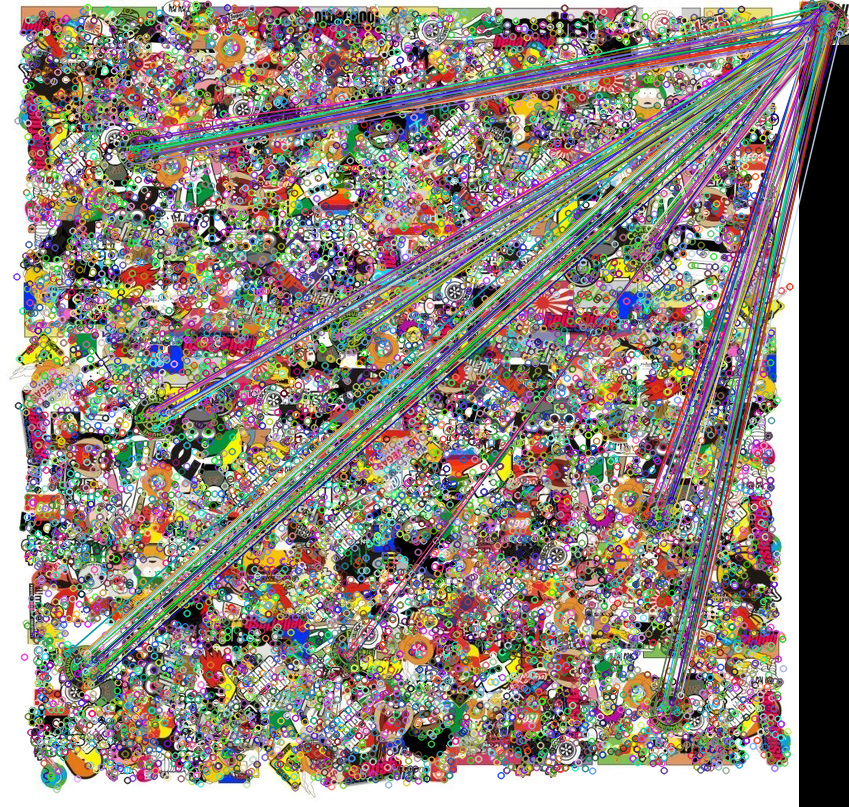

In [ ]:
cv2_imshow(cv2.drawMatchesKnn(collage, collage_kp, template, template_kp, matches1to2=good, outImg=out, flags=1))
# cv2.waitKey(0)
# cv2.destroyAllWindows()

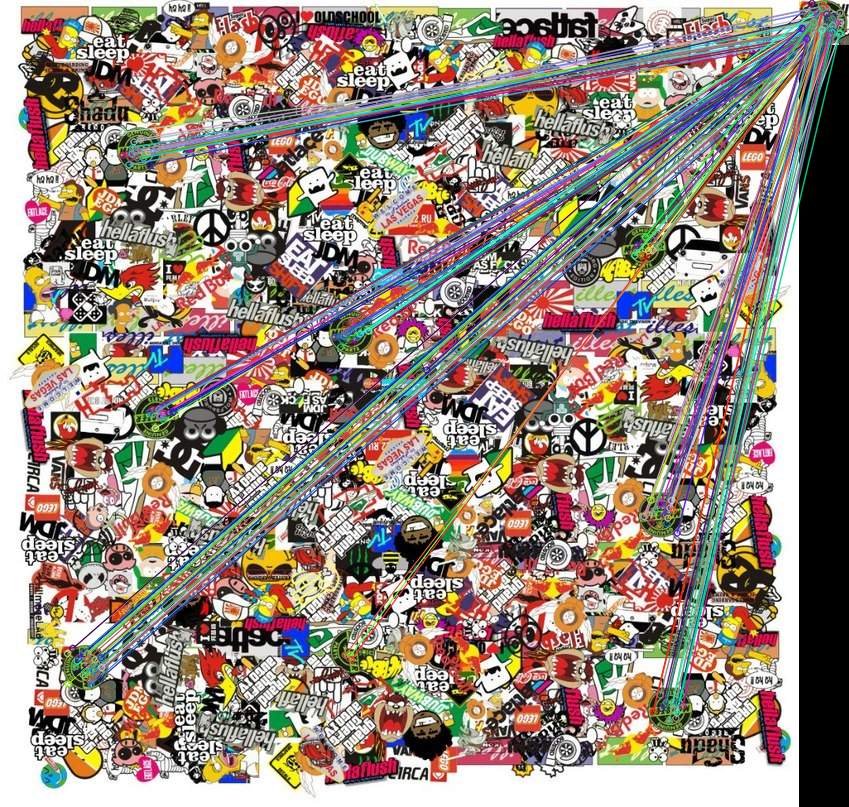

In [ ]:
cv2_imshow(cv2.drawMatchesKnn(collage, collage_kp, template, template_kp, matches1to2=good, outImg=None, flags=2))
# cv2.waitKey(0)
# cv2.destroyAllWindows()

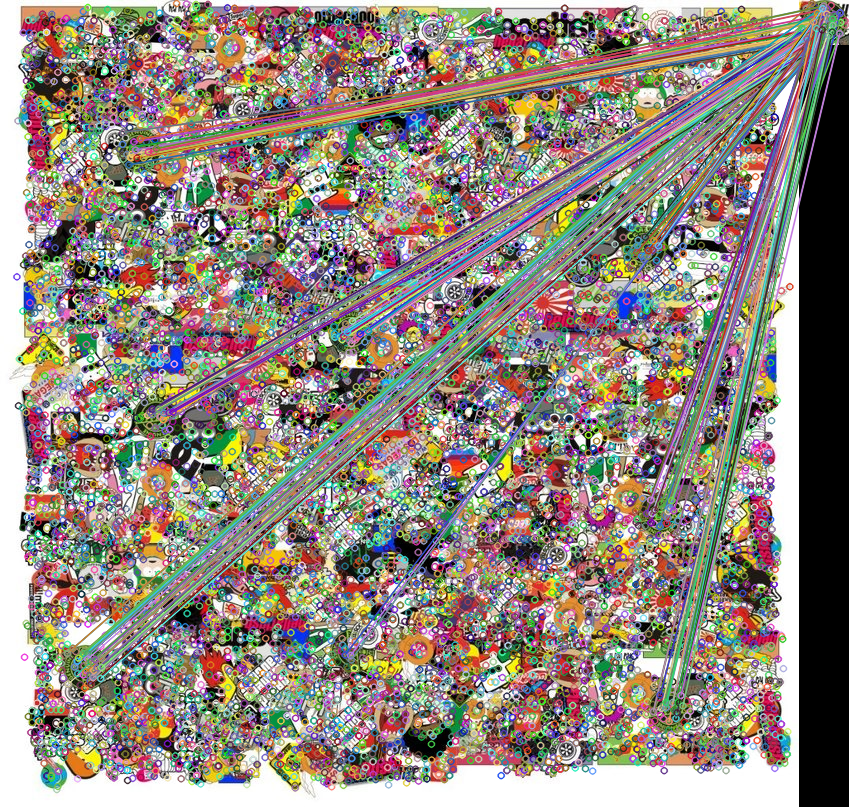

In [ ]:
cv2_imshow(cv2.drawMatchesKnn(collage, collage_kp, template, template_kp, matches1to2=good, outImg=out, flags=3))
# cv2.waitKey(0)
# cv2.destroyAllWindows()

Используя FLANN (flann.knnMatch, flann.knnSearch, …) получить соответствия особых точек шаблона и изображения. Вывести координаты и отобразить на шаблоне и изображении первые три особые точки, которые соответствуют друг друга на шаблоне и изображении.

In [ ]:
def search_first_n_points(image, template, max_points, title="res"):
    image_kp, image_des = sift.detectAndCompute(image, None)
    template_kp, template_des = sift.detectAndCompute(template, None)

    FLANN_INDEX_KDTREE = 0
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=100)

    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(image_des, template_des, k=2)
    (m,n) = matches[0]
    print('m = ',m.distance, m.imgIdx, m.queryIdx, m.trainIdx)
    print('n = ',n.distance, n.imgIdx, n.queryIdx, n.trainIdx)

    count_points = 0

    matchesMask = [[0, 0] for i in range(len(matches))] # Создаем маску, чтобы отобразить только лучшие соответствия
    for i, (m, n) in enumerate(matches):
        if m.distance < 0.5 * n.distance:
            if count_points < max_points:
                matchesMask[i] = [1, 0]
                count_points += 1
            else:
                break

    draw_params = dict(matchColor=(0, 255, 0), singlePointColor=(255, 0, 0), matchesMask=matchesMask, flags=2)
    res = cv2.drawMatchesKnn(image, image_kp, template, template_kp, matches, None, **draw_params)
    cv2_imshow(res)
    # cv2.waitKey(0)
    # cv2.destroyAllWindows()


m =  435.3010559082031 0 0 6
n =  440.50653076171875 0 0 45


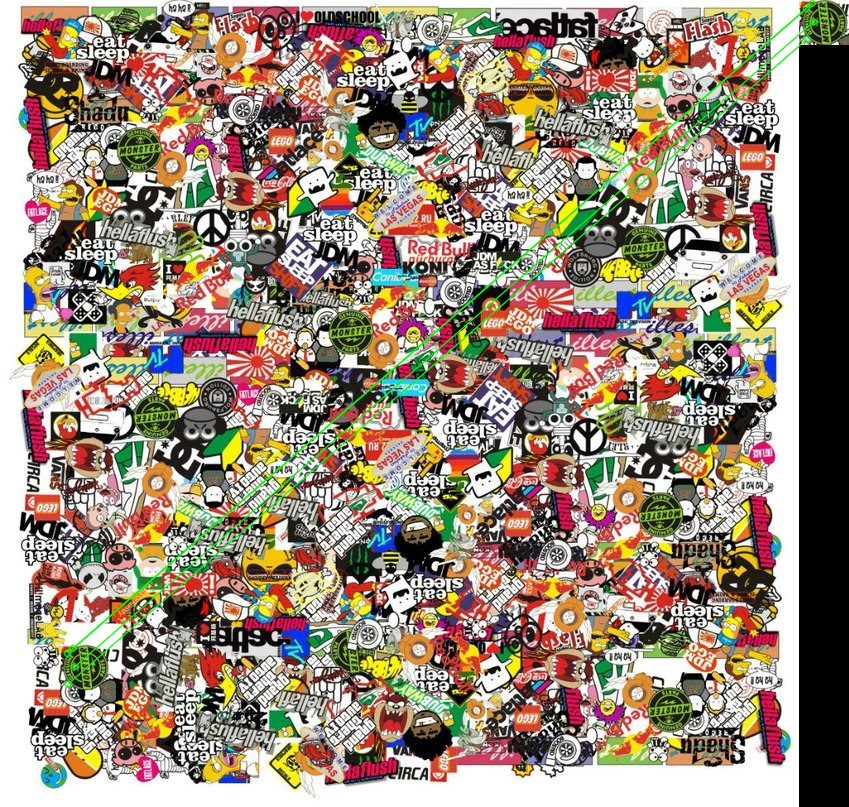

In [ ]:
search_first_n_points(collage, template, 4)

Над изображением выполнить преобразования. Для шаблона и каждого из полученных изображений, используя FLANN и cv2.drawMatchesKnn, отобразить соответствия особых точек.


Повернуть на 90 градусов

m =  400.93389892578125 0 0 6
n =  413.5903625488281 0 0 45


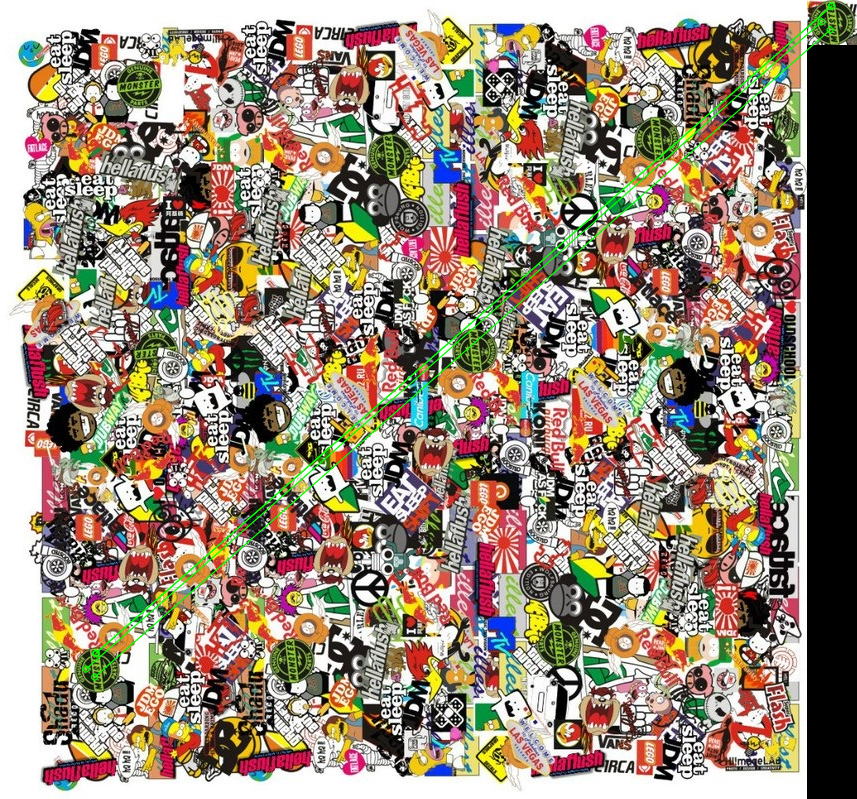

In [ ]:
rotated_collage = cv2.rotate(collage, cv2.ROTATE_90_CLOCKWISE)
search_first_n_points(rotated_collage, template, 4, "90 degrees")

Повернуть на 210 градуcов

m =  417.76190185546875 0 0 1
n =  429.30291748046875 0 0 5


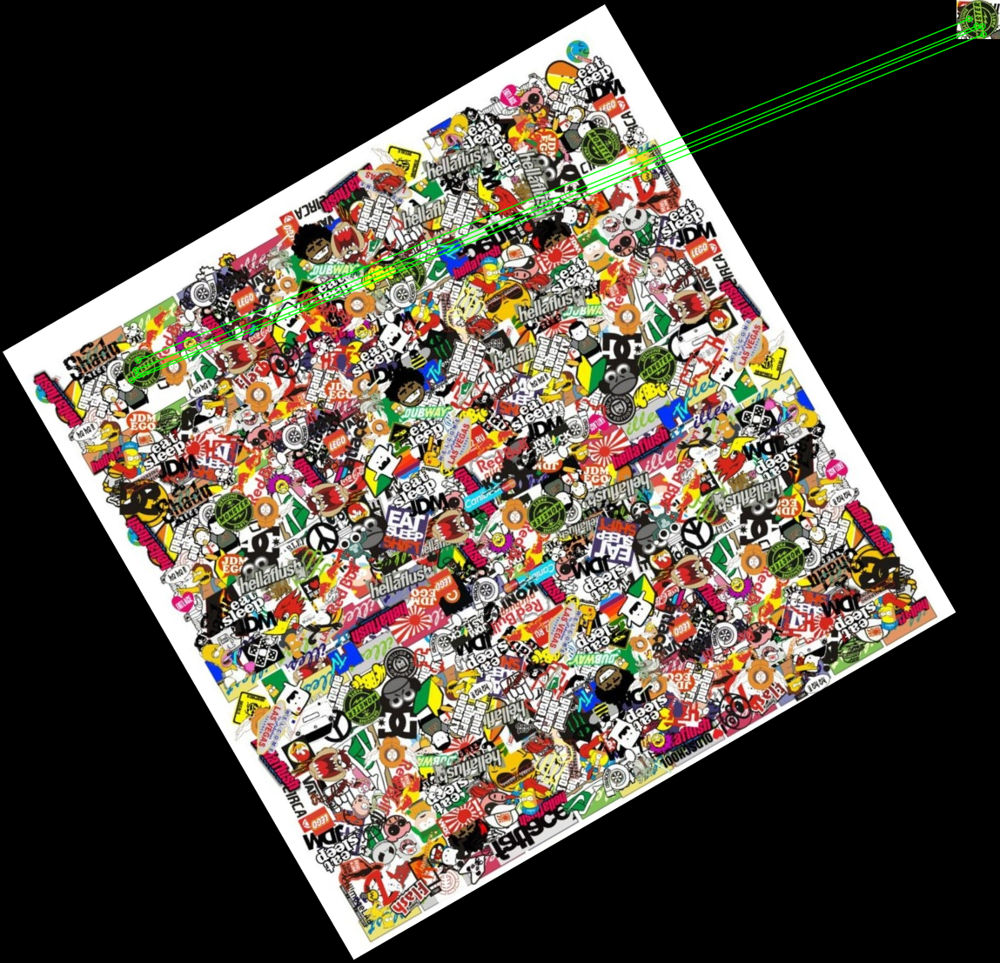

In [ ]:
border =  cv2.copyMakeBorder(collage, 150, 150, 150, 150, cv2.BORDER_CONSTANT, value=(0, 0, 0))
num_rows, num_cols = border.shape[:2]
r_matrix = cv2.getRotationMatrix2D((num_cols / 2, num_rows / 2), 210, 1)
rotated_collage = cv2.warpAffine(border, r_matrix, (num_cols, num_rows))
search_first_n_points(rotated_collage, template, 4, "210 degrees")

Растянуть (масштабирование) в 2 раза

m =  418.0645751953125 0 0 12
n =  418.6430358886719 0 0 11


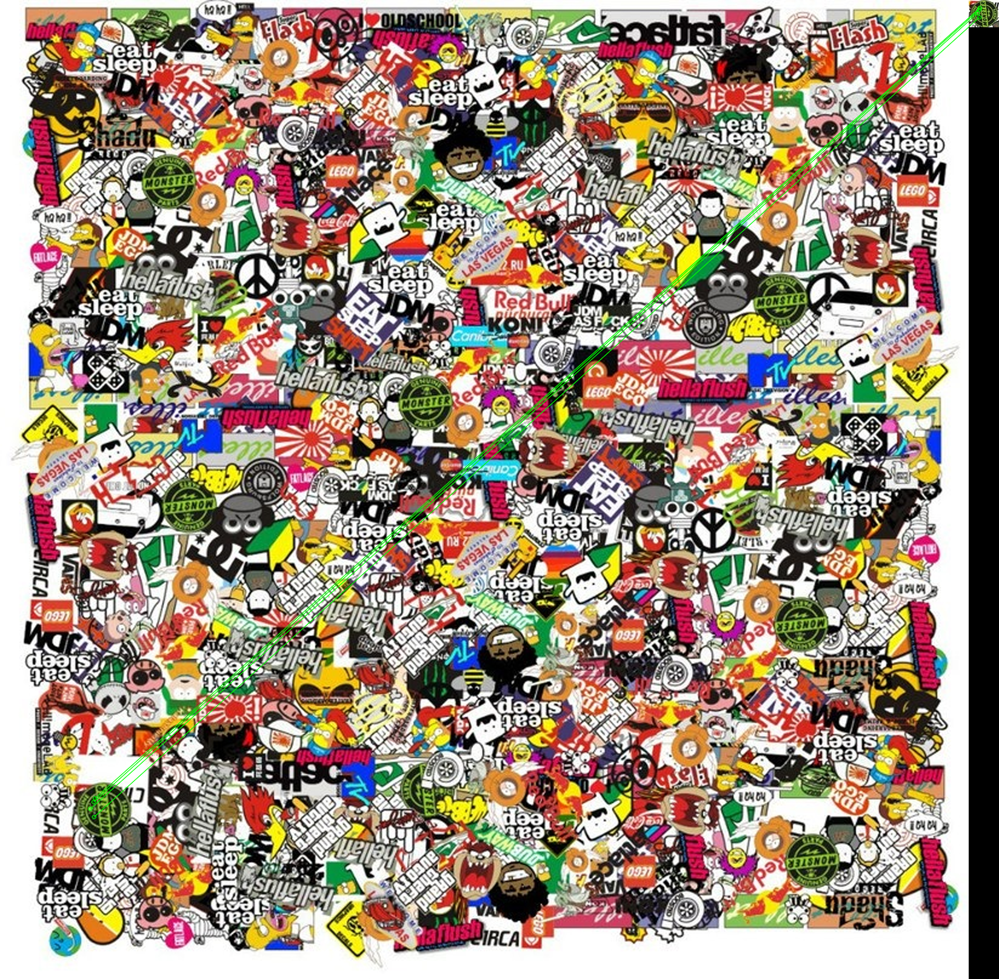

In [ ]:
resized_collage = cv2.resize(collage, None, fx=2, fy=2, interpolation=cv2.INTER_CUBIC)
search_first_n_points(resized_collage, template, 4, "resize x2")

Выполнить масштабирование с коэффициентом 0,5.

m =  431.64569091796875 0 0 6
n =  435.4112854003906 0 0 45


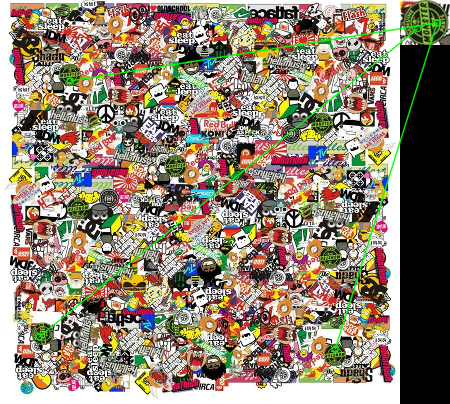

In [ ]:
resized_collage = cv2.resize(collage, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_CUBIC)
search_first_n_points(resized_collage, template, 4, "resize x0.5")

Повернуть на 270 град, растянуть в 1,5 раза.

m =  356.2372741699219 0 0 37
n =  369.1327819824219 0 0 9


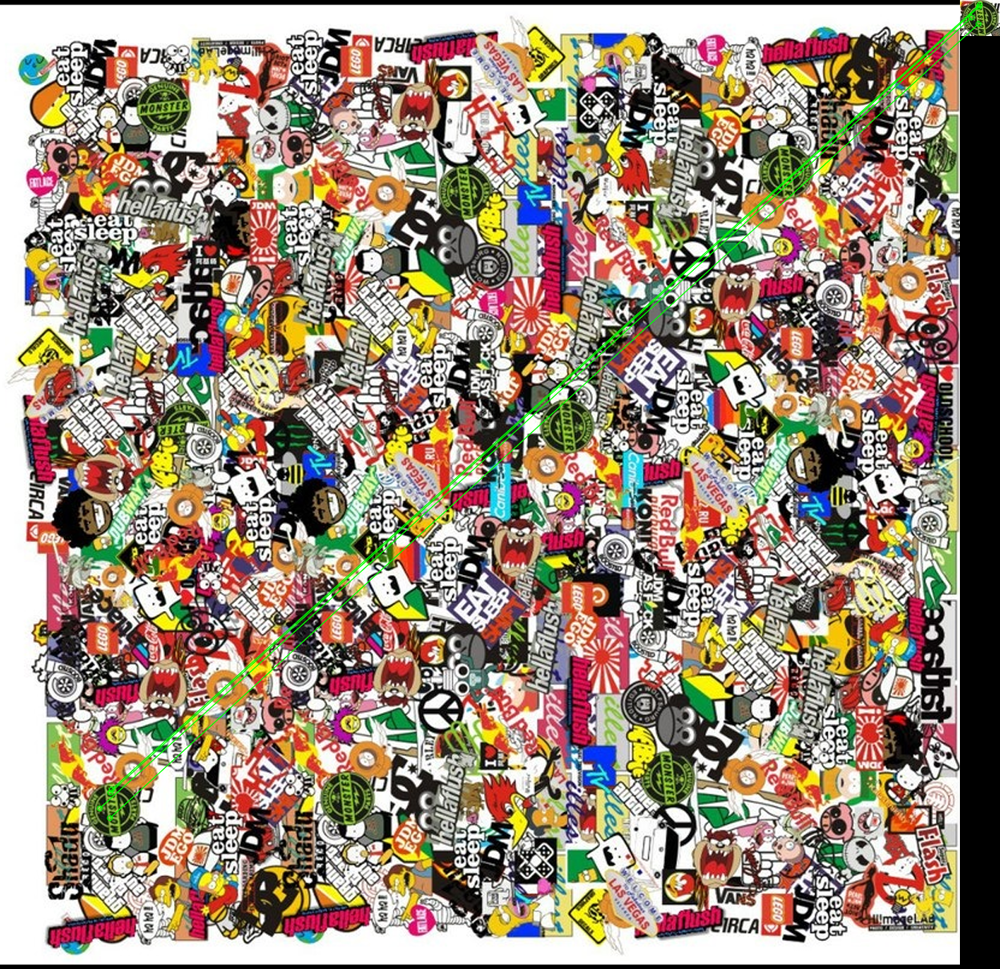

In [ ]:
num_rows, num_cols = collage.shape[:2]
r_matrix = cv2.getRotationMatrix2D((num_cols / 2, num_rows / 2), 270, 1)
rotated_collage = cv2.warpAffine(collage, r_matrix, (num_cols, num_rows))
resized_collage = cv2.resize(rotated_collage, None, fx=1.5, fy=1.5, interpolation=cv2.INTER_CUBIC)
search_first_n_points(resized_collage, template, 4, "210 degrees + resize x1.5")